<a href="https://colab.research.google.com/github/cagBRT/computer-vision/blob/master/opencv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

upload images<br>
cat_02.jpg,cat_03.jpg,cat_04.jpg,dog.jpg,island.jpg

In [ ]:
import numpy as np
import imutils
import cv2
from google.colab.patches import cv2_imshow

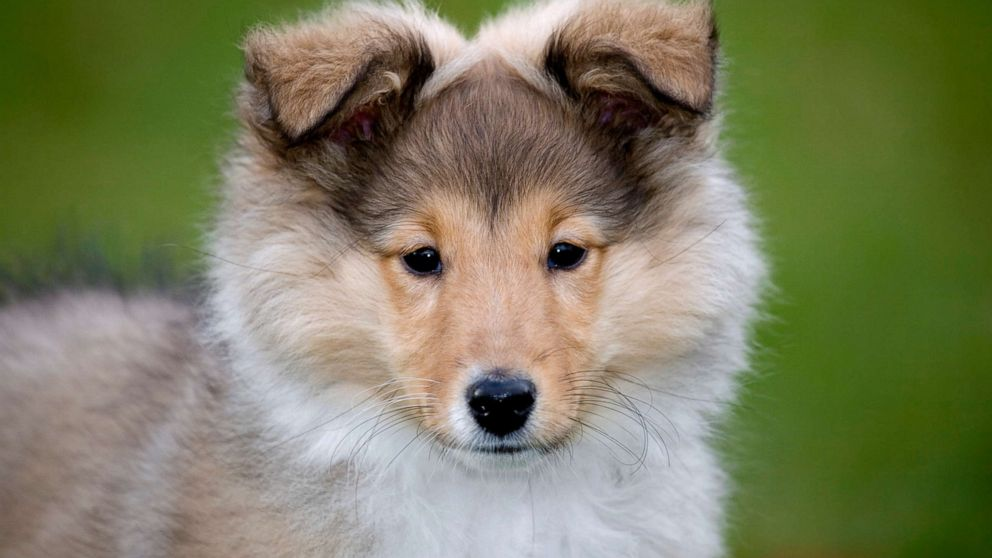

In [ ]:
image = cv2.imread("dog.jpg")
cv2_imshow(image)

OpenCV expects this ma- trix to be of floating point type. The first row of the matrix is [1,0,tx], where tx is the number of pixels we will shift the image left or right. Negative values of tx will shift the image to the left and positive values will shift the image to the right.

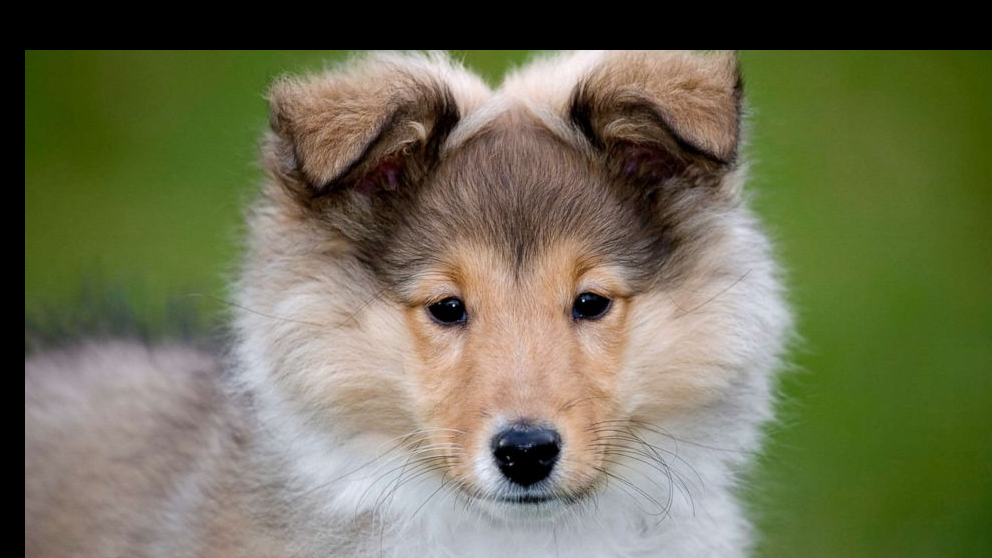

In [ ]:
M = np.float32([[1, 0, 25], [0, 1, 50]])
shifted = cv2.warpAffine(image, M, (image.shape[1], image.shape[0]))
cv2_imshow(shifted)

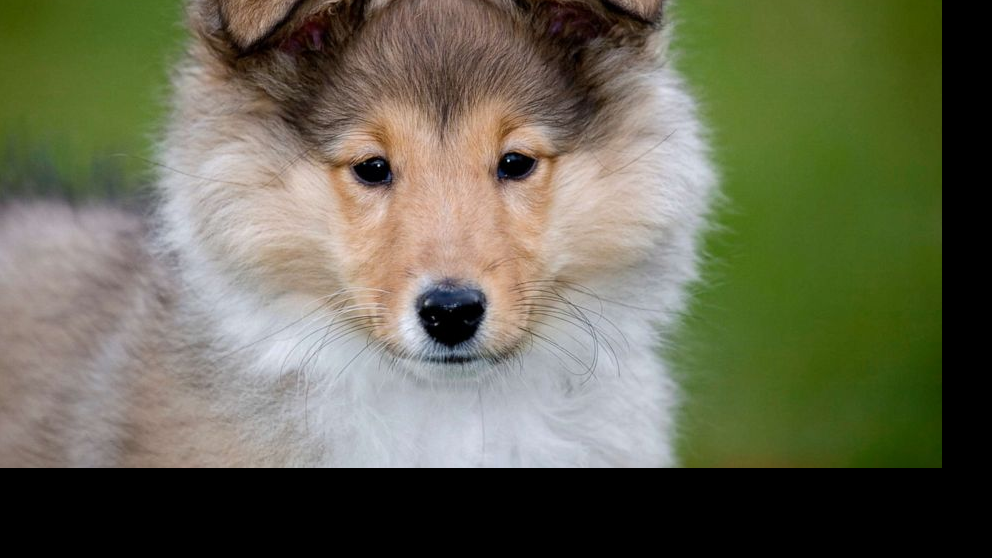

In [ ]:
M = np.float32([[1, 0, -50], [0, 1, -90]])
shifted = cv2.warpAffine(image, M, (image.shape[1], image.shape[0]))
cv2_imshow( shifted)

In [ ]:
#the number of pixels that we are going to shift along the x-axis, 
#and the number of pixels we are going to shift along the y-axis
def translate(image, x, y):
  M = np.float32([[1, 0, x], [0, 1, y]])
  shifted = cv2.warpAffine(image, M, (image.shape[1], image.
  shape[0]))
  return shifted

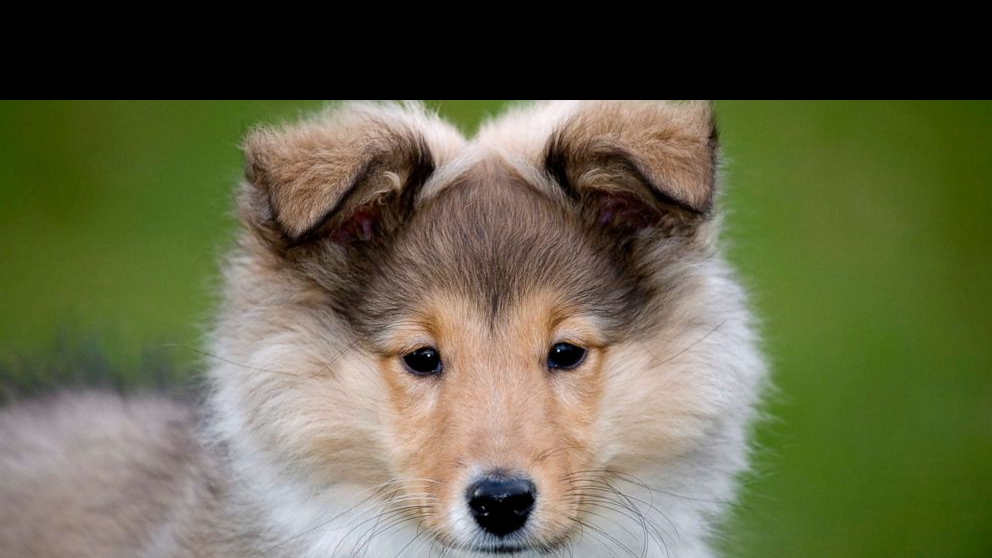

In [ ]:
shifted = imutils.translate(image, 0, 100)
cv2_imshow(shifted)

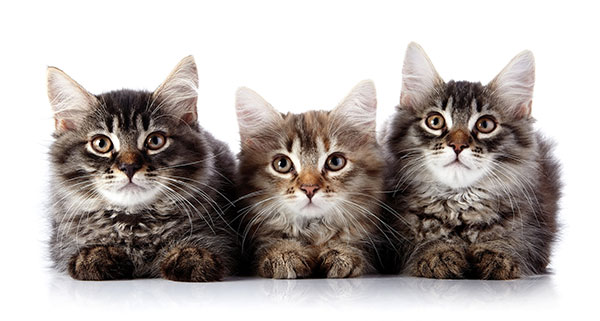

In [ ]:
image = cv2.imread("cat_04.jpg")
cv2_imshow(image)

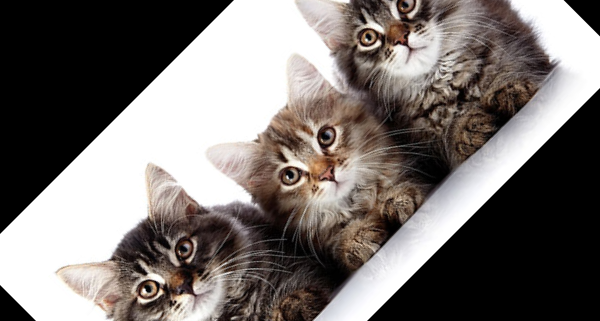

In [ ]:
(h, w) = image.shape[:2]
center=(w//2,h//2)

M = cv2.getRotationMatrix2D(center, 45, 1.0)
rotated = cv2.warpAffine(image, M, (w, h))
cv2_imshow(rotated)

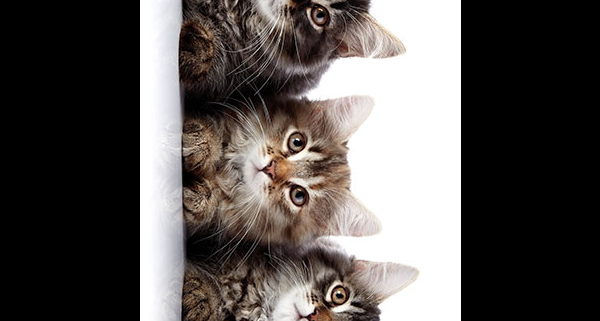

In [ ]:
M = cv2.getRotationMatrix2D(center, -90, 1.0)

rotated = cv2.warpAffine(image, M, (w, h))
cv2_imshow( rotated)


In [ ]:
def rotate(image, angle, center = None, scale = 1.0): 
  (h, w) = image.shape[:2]
  if center is None:
    center = (w // 2, h // 2)

  M = cv2.getRotationMatrix2D(center, angle, scale) 
  rotated = cv2.warpAffine(image, M, (w, h))
  return rotated

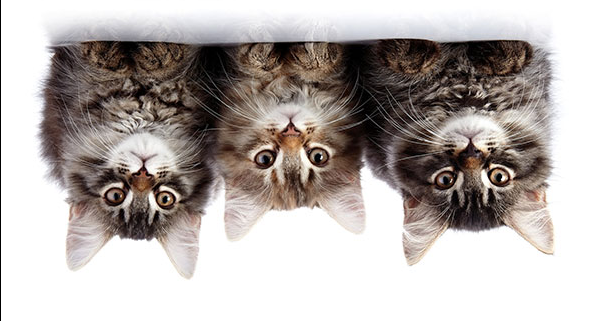

In [ ]:
rotated = imutils.rotate(image, 180)
cv2_imshow( rotated)

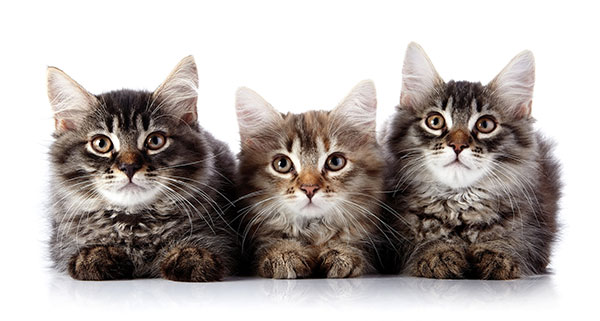

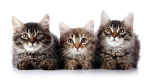

In [ ]:
image = cv2.imread("cat_04.jpg")
cv2_imshow( image) 

r = 150.0 / image.shape[1]
dim = (150, int(image.shape[0] * r))

resized = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)
cv2_imshow(resized)

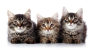

In [ ]:
r = 50.0 / image.shape[0]
dim = (int(image.shape[1] * r), 50)

resized = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)
cv2_imshow(resized)

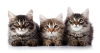

In [ ]:
resized = imutils.resize(image, width = 100)
cv2_imshow(resized)

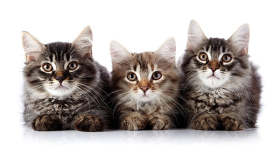

In [ ]:
resized = imutils.resize(image, height = 150)
cv2_imshow(resized)

In [ ]:
def resize(image, width = None, height = None, inter = cv2. INTER_AREA):
  dim = None
  (h, w) = image.shape[:2]
  if width is None and height is None:
       return image
  if width is None:
       r = height / float(h)
       dim = (int(w * r), height)
  else:
       r = width / float(w)
       dim = (width, int(h * r))
  resized = cv2.resize(image, dim, interpolation = inter)
  return resized

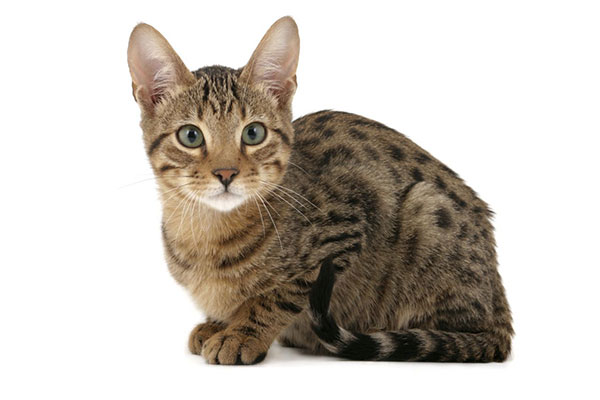

In [ ]:
image = cv2.imread("cat_03.jpg")
cv2_imshow(image)

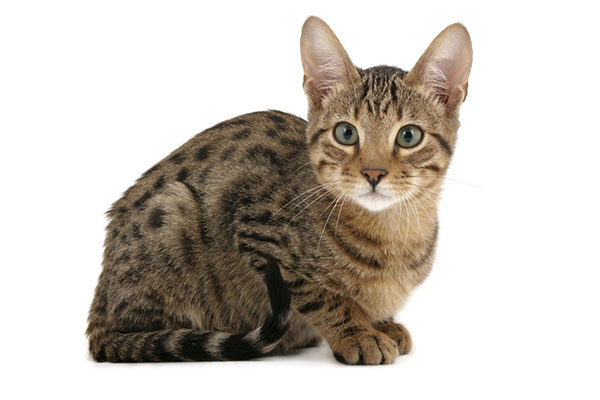

In [ ]:
flipped = cv2.flip(image, 1)
cv2_imshow(flipped)

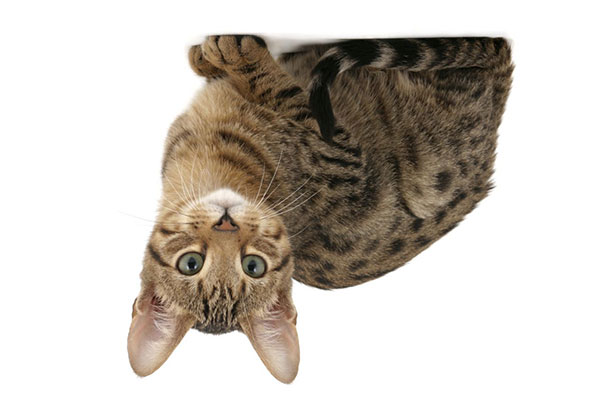

In [ ]:
flipped = cv2.flip(image, 0)
cv2_imshow(flipped)

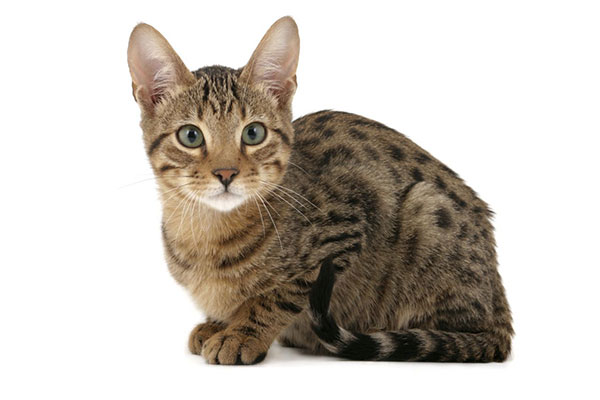

In [ ]:
image = cv2.imread("cat_03.jpg")
cv2_imshow(image)

To perform our cropping, NumPy expects four indexes:
1. Start y: The starting y coordinate. In this case, we start at y = 30.
2. End y: The ending y coordinate. We will end our crop at y = 120.
3. Start x: The starting x coordinate of the slice. We start the crop at x = 240.
63
6.2 image arithmetic
4. End x: The ending x-axis coordinate of the slice. Our slice ends at x = 335.

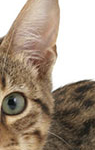

In [ ]:
cropped = image[30:180 , 240:335]
cv2_imshow(cropped)

RGB images have pixels that fall within the range [0, 255]. So what happens if we are examining a pixel with intensity 250 and we try to add 10 to it?
Under normal arithmetic rules, we would end up with a value of 260. However, since RGB images are represented as 8-bit unsigned integers, 260 is not a valid value.
So, what should happen? Should we perform a check of some sort to ensure no pixel falls outside the range of [0, 255], thus clipping all pixels to have a minimum value of 0 and a maximum value of 255?
Or do we apply a modulus operation, and “wrap around”? Under modulus rules, adding 10 to 250 would simply wrap around to a value of 4.

Which way is the “correct” way to handle image addi- tions and subtractions that fall outside the range of [0, 255]?
The answer is there is no correct way – it simply depends on how you are manipulate your pixels and what you want the desired results to be.
However, be sure to keep in mind that there is a differ- ence between OpenCV and NumPy addition. NumPy will perform modulo arithmetic and “wrap around”. OpenCV, on the other hand, will perform clipping and ensure pixel values never fall outside the range [0, 255].
But don’t worry! These nuances will become clearer as we explore some code below.

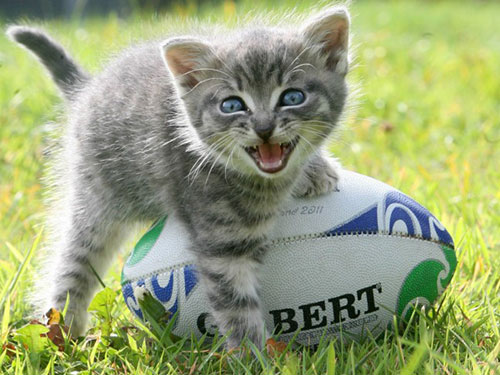

In [ ]:
image = cv2.imread("cat_02.jpg")
cv2_imshow( image)

In [ ]:
print("\nOpenCV arithmetic")
print("max of 255: {}".format(cv2.add(np.uint8([200]), np.uint8([100]))))
print("min of 0: {}".format(cv2.subtract(np.uint8([50]), np.uint8([100]))))
print("\nNumpy arithmetic")
print("wrap around: {}".format(np.uint8([200]) + np.uint8([100])))
print("wrap around: {}".format(np.uint8([50]) - np.uint8([100])))


OpenCV arithmetic
max of 255: [[255]]
min of 0: [[0]]

Numpy arithmetic
wrap around: [44]
wrap around: [206]


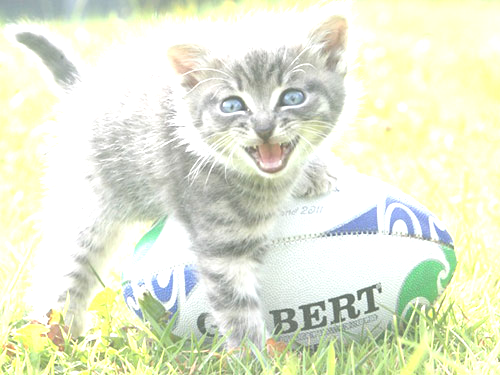

In [ ]:
M = np.ones(image.shape, dtype = "uint8") * 100
added = cv2.add(image, M)
cv2_imshow(added)

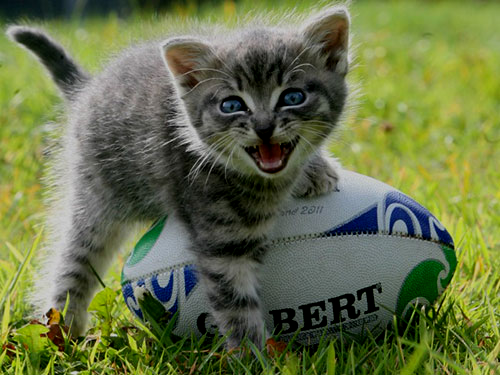

In [ ]:
M = np.ones(image.shape, dtype = "uint8") * 50
subtracted = cv2.subtract(image, M)
cv2_imshow(subtracted)


1. AND: A bitwise AND is true if and only if both pixels are greater than zero.
2. OR: A bitwise OR is true if either of the two pixels are greater than zero.
3. XOR: A bitwise XOR is true if and only if either of the two pixels are greater than zero, but not both.
4. NOT:AbitwiseNOTinvertsthe“on”and“off”pixels in an image.

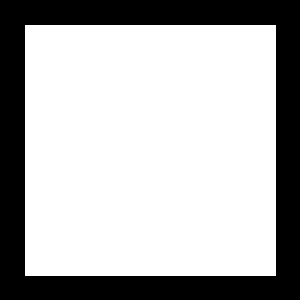

In [ ]:
rectangle = np.zeros((300, 300), dtype = "uint8")
cv2.rectangle(rectangle, (25, 25), (275, 275), 255, -1)
cv2_imshow(rectangle)

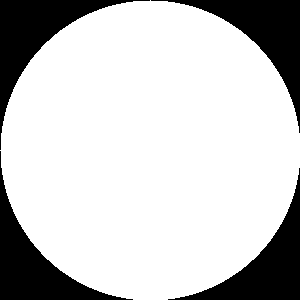

In [ ]:
circle = np.zeros((300, 300), dtype = "uint8")
cv2.circle(circle, (150, 150), 150, 255, -1)
cv2_imshow(circle)

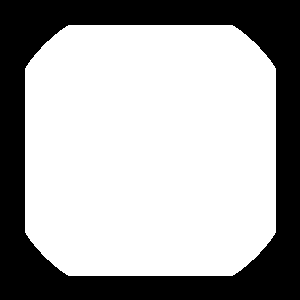

In [ ]:
bitwiseAnd = cv2.bitwise_and(rectangle, circle)
cv2_imshow( bitwiseAnd)

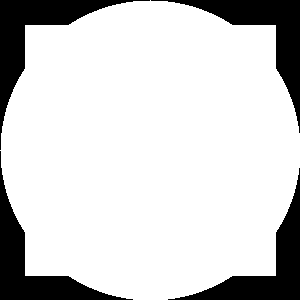

In [ ]:
bitwiseOr = cv2.bitwise_or(rectangle, circle)
cv2_imshow( bitwiseOr)

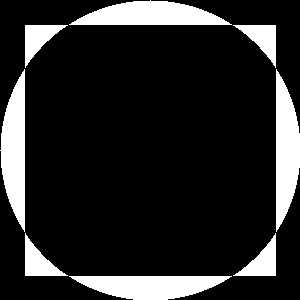

In [ ]:
bitwiseXor = cv2.bitwise_xor(rectangle, circle)
cv2_imshow( bitwiseXor)

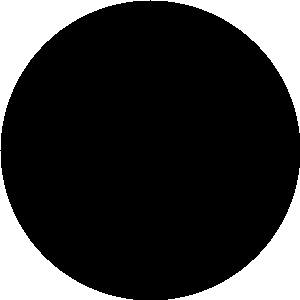

In [ ]:
bitwiseNot = cv2.bitwise_not(circle)
cv2_imshow(bitwiseNot)

# Masking

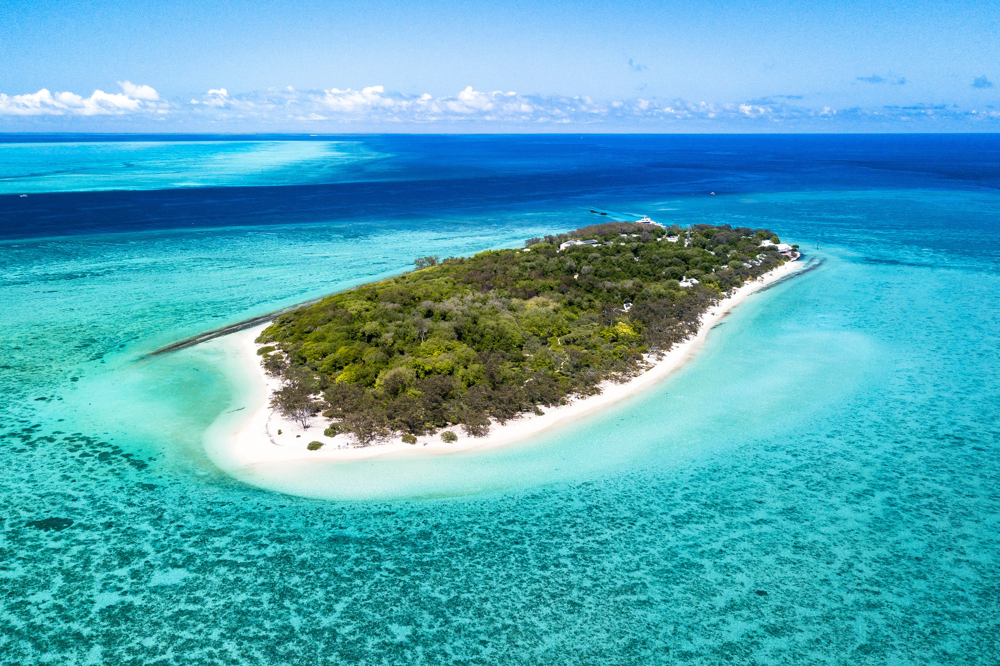

In [ ]:
image = cv2.imread("island.jpg")
cv2_imshow(image)

construct a NumPy array, filled with zeros, with the same width and height as our image

To draw the white rectangle, we first compute the center of the image on Line 14 by dividing the width and height by two, using the // operator to indicate integer divi- sion. Finally, we draw our white rectangle


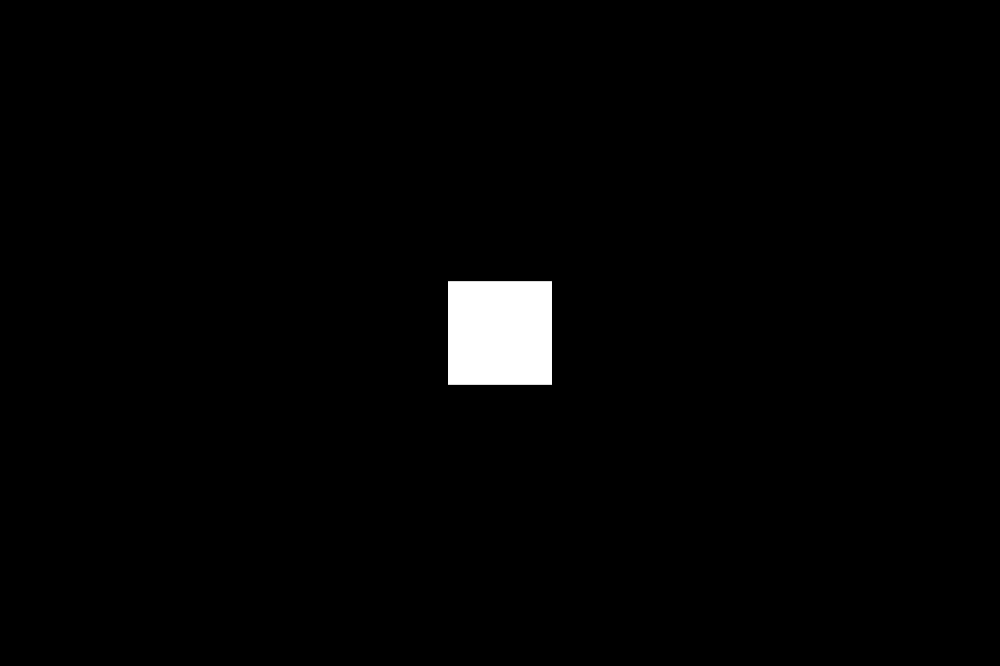

In [ ]:
mask = np.zeros(image.shape[:2], dtype = "uint8")
(cX, cY) = (image.shape[1] // 2, image.shape[0] // 2)
cv2.rectangle(mask, (cX - 175, cY - 175), (cX + 175 , cY + 175), 255,-1)
cv2_imshow(mask)

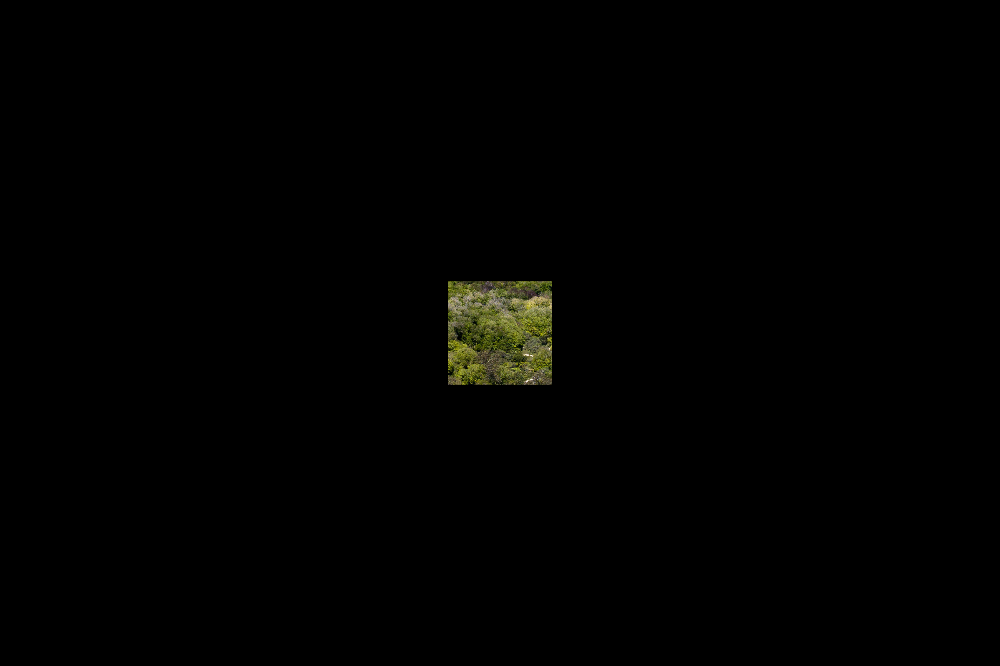

In [ ]:
masked = cv2.bitwise_and(image, image, mask = mask)
cv2_imshow(masked)

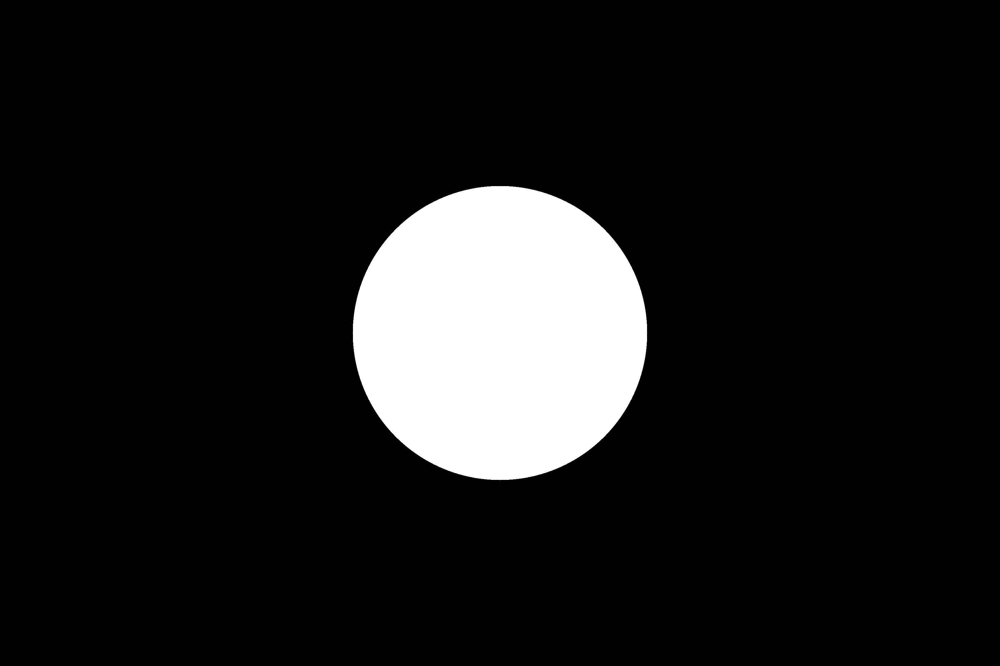

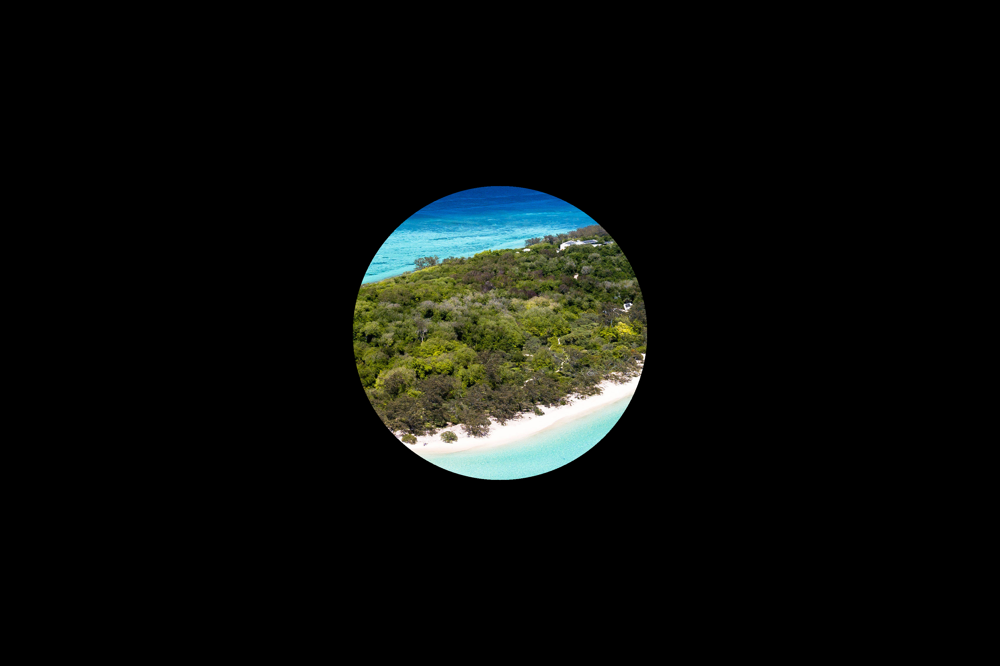

In [ ]:
mask = np.zeros(image.shape[:2], dtype = "uint8")
cv2.circle(mask, (cX, cY), 500, 255, -1)
masked = cv2.bitwise_and(image, image, mask = mask)
cv2_imshow(mask)
cv2_imshow(masked)